In [339]:
# Cargando las librerias requeridas
import numpy as np
import polars as pl
import pandas as pd

#Graficos
from plotnine import *
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly
import seaborn as sns

##Matriz de Correlacion
from dython import nominal



In [340]:
import warnings
warnings.filterwarnings('ignore')
warnings.warn('DelftStack')
warnings.warn('Do not show this message')
print("No Warning Shown")

No Warning Shown


In [341]:
# Se cargan datos
df_pistas= pd.read_csv("tracks.csv")
print(df_pistas.shape)
print(df_pistas.columns.values)
df_pistas.head()

(586672, 20)
['id' 'name' 'popularity' 'duration_ms' 'explicit' 'artists' 'id_artists'
 'release_date' 'danceability' 'energy' 'key' 'loudness' 'mode'
 'speechiness' 'acousticness' 'instrumentalness' 'liveness' 'valence'
 'tempo' 'time_signature']


,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,['Uli'],['45tIt06XoI0Iio4LBEVpls'],1922-02-22,0.645,0.4450,0,-13.338,1,0.4510,0.674,0.7440,0.151,0.127,104.851,3
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,['Fernando Pessoa'],['14jtPCOoNZwquk5wd9DxrY'],1922-06-01,0.695,0.2630,0,-22.136,1,0.9570,0.797,0.0000,0.148,0.655,102.009,1
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.434,0.1770,1,-21.180,1,0.0512,0.994,0.0218,0.212,0.457,130.418,5
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.321,0.0946,7,-27.961,1,0.0504,0.995,0.9180,0.104,0.397,169.980,3
4,08y9GfoqCWfOGsKdwojr5e,Lady of the Evening,0,163080,0,['Dick Haymes'],['3BiJGZsyX9sJchTqcSA7Su'],1922,0.402,0.1580,3,-16.900,0,0.0390,0.989,0.1300,0.311,0.196,103.220,4


In [342]:
print("Datos Null")
print(df_pistas.isnull().mean())

Datos Null
id                  0.000000
name                0.000121
popularity          0.000000
duration_ms         0.000000
explicit            0.000000
artists             0.000000
id_artists          0.000000
release_date        0.000000
danceability        0.000000
energy              0.000000
key                 0.000000
loudness            0.000000
mode                0.000000
speechiness         0.000000
acousticness        0.000000
instrumentalness    0.000000
liveness            0.000000
valence             0.000000
tempo               0.000000
time_signature      0.000000
dtype: float64


In [343]:
# Se seleccionan features
colFeatures = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 
             'loudness','speechiness','valence','duration_ms', 'explicit', 'time_signature', 'mode','tempo','popularity','release_date']


df_pistas = df_pistas[colFeatures]
print(df_pistas.shape)
df_pistas.describe()

(586672, 15)


,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,duration_ms,explicit,time_signature,mode,tempo,popularity
count,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,5.866720e+05,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000
mean,0.449863,0.563594,0.542036,0.113451,0.213935,-10.206067,0.104864,0.552292,2.300512e+05,0.044086,3.873382,0.658797,118.464857,27.570053
std,0.348837,0.166103,0.251923,0.266868,0.184326,5.089328,0.179893,0.257671,1.265261e+05,0.205286,0.473162,0.474114,29.764108,18.370642
min,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,3.344000e+03,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.096900,0.453000,0.343000,0.000000,0.098300,-12.891000,0.034000,0.346000,1.750930e+05,0.000000,4.000000,0.000000,95.600000,13.000000
50%,0.422000,0.577000,0.549000,0.000024,0.139000,-9.243000,0.044300,0.564000,2.148930e+05,0.000000,4.000000,1.000000,117.384000,27.000000
75%,0.785000,0.686000,0.748000,0.009550,0.278000,-6.482000,0.076300,0.769000,2.638670e+05,0.000000,4.000000,1.000000,136.321000,41.000000
max,0.996000,0.991000,1.000000,1.000000,1.000000,5.376000,0.971000,1.000000,5.621218e+06,1.000000,5.000000,1.000000,246.381000,100.000000


La data contiene 586672 canciones de spotify, incluyendo sus detalles (artista, álbum, track), ids internos de spotify así como variables numéricas, que representan atributos (features) musicales de esta.

Por ejemplo:
- acousticness ([0-1], estima que tan *acústica* es la canción)
- danceability ([0-1], estima que tan *bailable* es la canción)
- energy ([0-1], estima la intensidad y actividad de la canción) 
- instrumentalness ([0-1], estima que tan *instrumental* es la canción)
- liveness ([0-1] estima  si la canción es en vivo o no)
- loudness ([-60,0] estima la *sonoridad* de la canción, en decibeles promedio)
- speechiness ([0-1] estima la presencia de palabras en la canción)
- valence ([0-1], estima la *positividad* de la canción)
- tempo (mide los *beats por minuto* de la canción)
- key (integer 0 a 11, el tono de la canción. 0=Do, 1=Do#, 2=Re, etc)
- mode ({0,1}: 0 = Major, 1=Minor)
- time_signature (integer 3 a 7, estima el tiempo rítmico, valor 3 significa que es 3/4)
- duration_ms (duración en milisegundos de la canción)

(Mas info: https://developer.spotify.com/documentation/web-api/reference/#/operations/get-audio-features)

In [344]:
# Obtengo el año de lanzamiento del disco, lo dejo como entero.
df_pistas['album_release_year']= df_pistas['release_date'].str[:4].astype(int)
df_pistas.drop(['release_date'], axis=1, inplace = True)
print(df_pistas.shape)
df_pistas.head()

(586672, 15)


,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,duration_ms,explicit,time_signature,mode,tempo,popularity,album_release_year
0,0.674,0.645,0.4450,0.7440,0.151,-13.338,0.4510,0.127,126903,0,3,1,104.851,6,1922
1,0.797,0.695,0.2630,0.0000,0.148,-22.136,0.9570,0.655,98200,0,1,1,102.009,0,1922
2,0.994,0.434,0.1770,0.0218,0.212,-21.180,0.0512,0.457,181640,0,5,1,130.418,0,1922
3,0.995,0.321,0.0946,0.9180,0.104,-27.961,0.0504,0.397,176907,0,3,1,169.980,0,1922
4,0.989,0.402,0.1580,0.1300,0.311,-16.900,0.0390,0.196,163080,0,4,0,103.220,0,1922


(465342, 15)
Total de canciones por década:
decade
90s    108875
10s    105245
00s     86841
80s     82322
70s     61841
20s     20218
Name: count, dtype: int64


<Axes: xlabel='Decade', ylabel='Total of songs'>

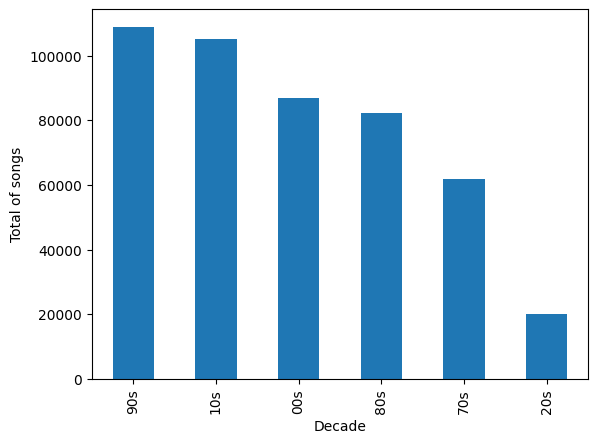

In [345]:
# Dejar del año 1970 en adelante y  se crea variable década

df_pistas = df_pistas[df_pistas['album_release_year'] >= 1970]
print(df_pistas.shape)
df_pistas["decade"]=pd.cut(df_pistas['album_release_year'],[1969,1979,1989,1999,2009,2019,2029],labels=["70s","80s","90s","00s","10s","20s"],ordered=False)

#Eliminamos la variable de año de lanzamiento, nos quedamos con la decada.
#df_pistas.drop(['album_release_year'], axis=1, inplace = True)
print('Total de canciones por década:')
print(df_pistas['decade'].value_counts())

df_pistas['decade'].value_counts().plot(kind='bar', xlabel='Decade', ylabel='Total of songs')

In [346]:
# Tratamiento variable duración, Existen canciones muy cortas y otras demasiado largas.
#Dejamos la variable en minutos
df_pistas['duration_min']=df_pistas['duration_ms']/(1000*60)
print(df_pistas['duration_min'].describe())

#Eliminar la variable de duracion en milisegundos.
df_pistas.drop(['duration_ms'], axis=1, inplace = True)
print(df_pistas.shape)
df_pistas.head()

px.box(data_frame=df_pistas,x=df_pistas['duration_min'])

count    465342.000000
mean          3.908752
std           1.966109
min           0.082283
25%           3.083333
50%           3.738450
75%           4.483333
max          93.686967
Name: duration_min, dtype: float64
(465342, 16)


Lower Limit: -1.9895752557329112
Upper Limit: 9.807079513891429


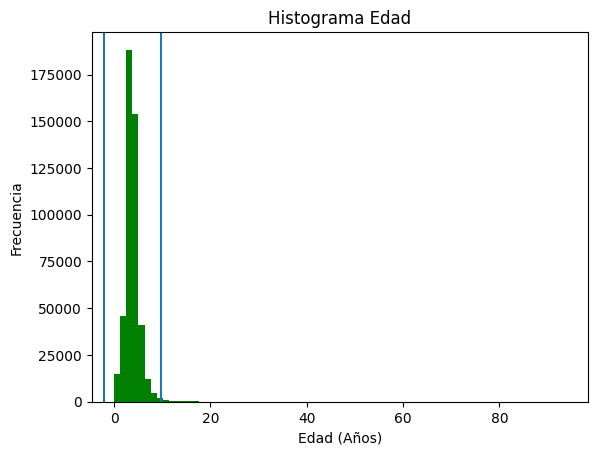

In [347]:
#Identificación Outliers usando Desviación Estandar
factor = 3
lower_lim_desv = df_pistas['duration_min'].mean() - df_pistas['duration_min'].std() * factor
upper_lim_desv = df_pistas['duration_min'].mean() + df_pistas['duration_min'].std() * factor
print(f'Lower Limit: {lower_lim_desv}\nUpper Limit: {upper_lim_desv}')


#Visualización Datos (Edad) - Upper Limit
plt.hist(df_pistas['duration_min'], bins=75, facecolor = 'g')
plt.xlabel('Edad (Años)')
plt.ylabel('Frecuencia')
plt.title('Histograma Edad')
plt.axvline(x=upper_lim_desv)
plt.axvline(x=lower_lim_desv)
plt.show()



In [348]:
#Eliminar Outliers usando 3 Desviaciones Estandar
df_pistas = df_pistas.loc[(df_pistas['duration_min'] <= upper_lim_desv) & (df_pistas['duration_min'] >= lower_lim_desv)]
print(df_pistas.shape)

px.box(data_frame=df_pistas,y='duration_min',color='decade')

(461696, 16)


array([[<Axes: title={'center': 'acousticness'}>,
        <Axes: title={'center': 'danceability'}>,
        <Axes: title={'center': 'energy'}>,
        <Axes: title={'center': 'instrumentalness'}>],
       [<Axes: title={'center': 'liveness'}>,
        <Axes: title={'center': 'loudness'}>,
        <Axes: title={'center': 'speechiness'}>,
        <Axes: title={'center': 'valence'}>],
       [<Axes: title={'center': 'explicit'}>,
        <Axes: title={'center': 'time_signature'}>,
        <Axes: title={'center': 'mode'}>,
        <Axes: title={'center': 'tempo'}>],
       [<Axes: title={'center': 'popularity'}>,
        <Axes: title={'center': 'album_release_year'}>,
        <Axes: title={'center': 'duration_min'}>, <Axes: >]], dtype=object)

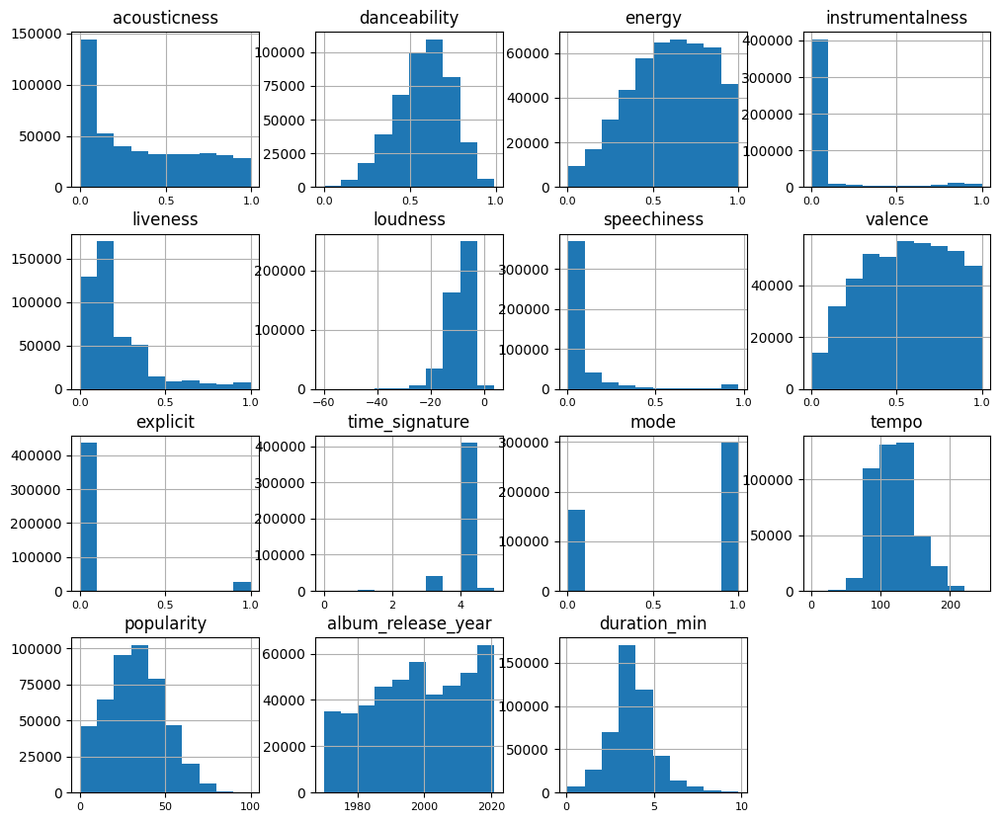

In [349]:
# Visualizando las variables escogidas
df_pistas.hist(xlabelsize=8, figsize=(12,10))

In [350]:
##Nos quedamos con las siguientes variables.
print(df_pistas.shape)
print(df_pistas.columns.values)
df_pistas.head()

(461696, 16)
['acousticness' 'danceability' 'energy' 'instrumentalness' 'liveness'
 'loudness' 'speechiness' 'valence' 'explicit' 'time_signature' 'mode'
 'tempo' 'popularity' 'album_release_year' 'decade' 'duration_min']


,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,explicit,time_signature,mode,tempo,popularity,album_release_year,decade,duration_min
39501,0.394,0.484,0.265,0.000000,0.149,-11.101,0.0322,0.285,0,3,1,113.564,56,2008,00s,2.669783
39511,0.436,0.671,0.867,0.000000,0.139,-2.706,0.0571,0.839,0,4,1,120.689,41,2020,20s,2.659333
39517,0.255,0.405,0.365,0.000005,0.163,-10.226,0.0289,0.588,0,4,0,104.536,40,2008,00s,2.366450
39521,0.406,0.477,0.352,0.000000,0.122,-14.165,0.0300,0.478,0,4,1,106.773,34,2008,00s,2.618217
39529,0.887,0.319,0.201,0.000000,0.904,-17.796,0.0623,0.239,0,3,1,117.153,26,2018,10s,3.122217


In [351]:
# Pasamos a variables categoricas.
df_pistas["decade"] = df_pistas["decade"].astype("category")
df_pistas["explicit"] = df_pistas["explicit"].astype("category")
df_pistas["mode"] = df_pistas["mode"].astype("category")
df_pistas["time_signature"] = df_pistas["time_signature"].astype("category")

In [352]:
val_categoricas = ["decade","explicit","mode","time_signature"]
val_numericas = ['acousticness','danceability','energy','instrumentalness','liveness','loudness','speechiness','valence','tempo','popularity','duration_min']

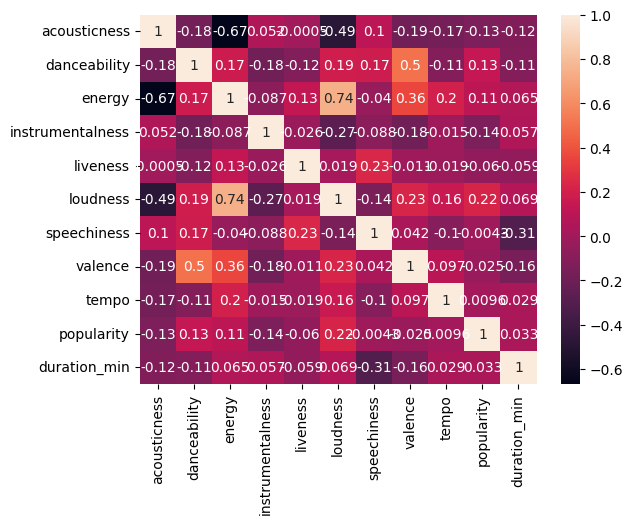

In [353]:
# Correlación entre features
corrMatrix = df_pistas[val_numericas].corr()
sns.heatmap(corrMatrix, annot=True)
plt.show()

In [354]:
print("Datos Null")
print(df_pistas.isnull().mean())

Datos Null
acousticness          0.0
danceability          0.0
energy                0.0
instrumentalness      0.0
liveness              0.0
loudness              0.0
speechiness           0.0
valence               0.0
explicit              0.0
time_signature        0.0
mode                  0.0
tempo                 0.0
popularity            0.0
album_release_year    0.0
decade                0.0
duration_min          0.0
dtype: float64


In [359]:
## Consumo de Drogas.
var_Dummies = pd.get_dummies(df_pistas.decade, prefix="decade")
df_pistas = pd.concat([df_pistas,var_Dummies], axis=1)
df_pistas 


,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,explicit,time_signature,...,popularity,album_release_year,decade,duration_min,decade_70s,decade_80s,decade_90s,decade_00s,decade_10s,decade_20s
39501,0.394,0.484,0.265,0.000000,0.1490,-11.101,0.0322,0.2850,0,3,...,56,2008,00s,2.669783,False,False,False,True,False,False
39511,0.436,0.671,0.867,0.000000,0.1390,-2.706,0.0571,0.8390,0,4,...,41,2020,20s,2.659333,False,False,False,False,False,True
39517,0.255,0.405,0.365,0.000005,0.1630,-10.226,0.0289,0.5880,0,4,...,40,2008,00s,2.366450,False,False,False,True,False,False
39521,0.406,0.477,0.352,0.000000,0.1220,-14.165,0.0300,0.4780,0,4,...,34,2008,00s,2.618217,False,False,False,True,False,False
39529,0.887,0.319,0.201,0.000000,0.9040,-17.796,0.0623,0.2390,0,3,...,26,2018,10s,3.122217,False,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586667,0.785,0.560,0.518,0.000000,0.0648,-7.471,0.0292,0.2110,0,4,...,50,2020,20s,4.304450,False,False,False,False,False,True
586668,0.141,0.765,0.663,0.000297,0.0924,-5.223,0.0652,0.6860,0,4,...,72,2020,20s,2.554883,False,False,False,False,False,True
586669,0.895,0.535,0.314,0.000150,0.0874,-12.823,0.0408,0.0663,0,4,...,70,2020,20s,3.126683,False,False,False,False,False,True
586670,0.206,0.696,0.615,0.000003,0.3050,-6.212,0.0345,0.4380,0,4,...,58,2021,20s,2.366717,False,False,False,False,False,True


,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,valence,explicit,time_signature,...,tempo,popularity,album_release_year,decade,duration_min,0,1,2,3,4
39501,0.3940,0.484,0.265,0.000000,0.1490,-11.101,0.0322,0.285,0,3,...,113.564,56,2008,00s,2.669783,0.0,0.0,0.0,0.0,0.0
39511,0.4360,0.671,0.867,0.000000,0.1390,-2.706,0.0571,0.839,0,4,...,120.689,41,2020,20s,2.659333,1.0,0.0,0.0,0.0,0.0
39517,0.2550,0.405,0.365,0.000005,0.1630,-10.226,0.0289,0.588,0,4,...,104.536,40,2008,00s,2.366450,1.0,0.0,0.0,0.0,0.0
39521,0.4060,0.477,0.352,0.000000,0.1220,-14.165,0.0300,0.478,0,4,...,106.773,34,2008,00s,2.618217,0.0,0.0,0.0,0.0,0.0
39529,0.8870,0.319,0.201,0.000000,0.9040,-17.796,0.0623,0.239,0,3,...,117.153,26,2018,10s,3.122217,0.0,0.0,0.0,0.0,0.0
39533,0.9380,0.269,0.129,0.000005,0.6830,-18.168,0.0576,0.160,0,3,...,82.332,25,2018,10s,3.946667,0.0,0.0,0.0,0.0,0.0
39537,0.3600,0.617,0.711,0.000002,0.0841,-6.433,0.0297,0.963,0,4,...,142.266,29,2008,00s,1.916450,0.0,0.0,0.0,0.0,0.0
39551,0.2880,0.409,0.639,0.000000,0.3430,-7.628,0.0302,0.928,0,4,...,145.903,25,2008,00s,1.920667,0.0,0.0,0.0,0.0,0.0
39561,0.7640,0.459,0.344,0.000594,0.1110,-12.205,0.0301,0.487,0,4,...,106.479,23,2008,00s,2.646667,1.0,0.0,0.0,0.0,0.0
39565,0.5000,0.399,0.296,0.000000,0.0719,-12.364,0.0294,0.658,0,4,...,107.098,23,2008,00s,2.403333,1.0,0.0,0.0,0.0,0.0
